## Import Dataset

In [113]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.linear_model import LogisticRegression

## Membaca data csv ke Dataframe Pandas
data = pd.read_csv('general_data.csv') #Data untuk training dan testing model, 
# file csv diharapkan diupdate secara berkala supaya model juga 
# engikuti perkembangan attrition rate perusahaan

#data survey berdasarkan penilaian subjektif manager dan karyawan
manager_survey = pd.read_csv('manager_survey_data.csv')
employee_survey = pd.read_csv('employee_survey_data.csv')

## Merge Data

In [114]:
df_all = data.merge(manager_survey, on = 'EmployeeID', how = "left") #merge berdasarkan bagian kiri Dataframe

In [115]:
df_all

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeID,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,Over18,PercentSalaryHike,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,JobInvolvement,PerformanceRating
0,51,No,Travel_Rarely,Sales,6,2,Life Sciences,1,1,Female,1,Healthcare Representative,Married,131160,1.0,Y,11,8,0,1.0,6,1,0,0,3,3
1,31,Yes,Travel_Frequently,Research & Development,10,1,Life Sciences,1,2,Female,1,Research Scientist,Single,41890,0.0,Y,23,8,1,6.0,3,5,1,4,2,4
2,32,No,Travel_Frequently,Research & Development,17,4,Other,1,3,Male,4,Sales Executive,Married,193280,1.0,Y,15,8,3,5.0,2,5,0,3,3,3
3,38,No,Non-Travel,Research & Development,2,5,Life Sciences,1,4,Male,3,Human Resources,Married,83210,3.0,Y,11,8,3,13.0,5,8,7,5,2,3
4,32,No,Travel_Rarely,Research & Development,10,1,Medical,1,5,Male,1,Sales Executive,Single,23420,4.0,Y,12,8,2,9.0,2,6,0,4,3,3
5,46,No,Travel_Rarely,Research & Development,8,3,Life Sciences,1,6,Female,4,Research Director,Married,40710,3.0,Y,13,8,0,28.0,5,7,7,7,3,3
6,28,Yes,Travel_Rarely,Research & Development,11,2,Medical,1,7,Male,2,Sales Executive,Single,58130,2.0,Y,20,8,1,5.0,2,0,0,0,3,4
7,29,No,Travel_Rarely,Research & Development,18,3,Life Sciences,1,8,Male,2,Sales Executive,Married,31430,2.0,Y,22,8,3,10.0,2,0,0,0,3,4
8,31,No,Travel_Rarely,Research & Development,1,3,Life Sciences,1,9,Male,3,Laboratory Technician,Married,20440,0.0,Y,21,8,0,10.0,2,9,7,8,3,4
9,25,No,Non-Travel,Research & Development,7,4,Medical,1,10,Female,4,Laboratory Technician,Divorced,134640,1.0,Y,13,8,1,6.0,2,6,1,5,3,3


In [116]:
df_all = df_all.merge(employee_survey, on = 'EmployeeID', how = "left")

In [117]:
df_all

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeID,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,Over18,PercentSalaryHike,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,JobInvolvement,PerformanceRating,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance
0,51,No,Travel_Rarely,Sales,6,2,Life Sciences,1,1,Female,1,Healthcare Representative,Married,131160,1.0,Y,11,8,0,1.0,6,1,0,0,3,3,3.0,4.0,2.0
1,31,Yes,Travel_Frequently,Research & Development,10,1,Life Sciences,1,2,Female,1,Research Scientist,Single,41890,0.0,Y,23,8,1,6.0,3,5,1,4,2,4,3.0,2.0,4.0
2,32,No,Travel_Frequently,Research & Development,17,4,Other,1,3,Male,4,Sales Executive,Married,193280,1.0,Y,15,8,3,5.0,2,5,0,3,3,3,2.0,2.0,1.0
3,38,No,Non-Travel,Research & Development,2,5,Life Sciences,1,4,Male,3,Human Resources,Married,83210,3.0,Y,11,8,3,13.0,5,8,7,5,2,3,4.0,4.0,3.0
4,32,No,Travel_Rarely,Research & Development,10,1,Medical,1,5,Male,1,Sales Executive,Single,23420,4.0,Y,12,8,2,9.0,2,6,0,4,3,3,4.0,1.0,3.0
5,46,No,Travel_Rarely,Research & Development,8,3,Life Sciences,1,6,Female,4,Research Director,Married,40710,3.0,Y,13,8,0,28.0,5,7,7,7,3,3,3.0,2.0,2.0
6,28,Yes,Travel_Rarely,Research & Development,11,2,Medical,1,7,Male,2,Sales Executive,Single,58130,2.0,Y,20,8,1,5.0,2,0,0,0,3,4,1.0,3.0,1.0
7,29,No,Travel_Rarely,Research & Development,18,3,Life Sciences,1,8,Male,2,Sales Executive,Married,31430,2.0,Y,22,8,3,10.0,2,0,0,0,3,4,1.0,2.0,3.0
8,31,No,Travel_Rarely,Research & Development,1,3,Life Sciences,1,9,Male,3,Laboratory Technician,Married,20440,0.0,Y,21,8,0,10.0,2,9,7,8,3,4,2.0,4.0,3.0
9,25,No,Non-Travel,Research & Development,7,4,Medical,1,10,Female,4,Laboratory Technician,Divorced,134640,1.0,Y,13,8,1,6.0,2,6,1,5,3,3,2.0,1.0,3.0


## Data Cleaning

In [118]:
df_all.isna().sum() #mengecek keberadaan data null pada dataset

Age                        0 
Attrition                  0 
BusinessTravel             0 
Department                 0 
DistanceFromHome           0 
Education                  0 
EducationField             0 
EmployeeCount              0 
EmployeeID                 0 
Gender                     0 
JobLevel                   0 
JobRole                    0 
MaritalStatus              0 
MonthlyIncome              0 
NumCompaniesWorked         19
Over18                     0 
PercentSalaryHike          0 
StandardHours              0 
StockOptionLevel           0 
TotalWorkingYears          9 
TrainingTimesLastYear      0 
YearsAtCompany             0 
YearsSinceLastPromotion    0 
YearsWithCurrManager       0 
JobInvolvement             0 
PerformanceRating          0 
EnvironmentSatisfaction    25
JobSatisfaction            20
WorkLifeBalance            38
dtype: int64

Diperoleh bahwa utk feature di general_data.csv NumCompaniesWorked dan TotalWorkingYears masing-masing memiliki 19 dan 9 data NaN

Sebelum melakukan data cleaning, dilakukan copy dataframe utk tetap menyimpan data original

In [119]:
df=df_all.copy() #copy data ke dataframe baru

In [120]:
# df.sort_values(by='NumCompaniesWorked', ascending=True) #sort df utk memperoleh 

#Kemungkinan nilai NumCompaniesWorked: 
#1. years at company = total working years; 
#2. years at company < total working years;
# Utk case 2, tdk bisa diperoleh data NumCompaniesWorked, maka data dihapus
# Utk case 1, NumCompaniesWorked=0

# Memperbaiki data (utk case 1)
df.loc[df['YearsAtCompany']/1.0 == df['TotalWorkingYears'], 'NumCompaniesWorked'] = 0

In [121]:
df.isna().sum() #mengecek kembali data NaN

Age                        0 
Attrition                  0 
BusinessTravel             0 
Department                 0 
DistanceFromHome           0 
Education                  0 
EducationField             0 
EmployeeCount              0 
EmployeeID                 0 
Gender                     0 
JobLevel                   0 
JobRole                    0 
MaritalStatus              0 
MonthlyIncome              0 
NumCompaniesWorked         14
Over18                     0 
PercentSalaryHike          0 
StandardHours              0 
StockOptionLevel           0 
TotalWorkingYears          9 
TrainingTimesLastYear      0 
YearsAtCompany             0 
YearsSinceLastPromotion    0 
YearsWithCurrManager       0 
JobInvolvement             0 
PerformanceRating          0 
EnvironmentSatisfaction    25
JobSatisfaction            20
WorkLifeBalance            38
dtype: int64

In [122]:
#bila NumCompaniesWorked = 0 (karyawan belum pernah bekerja di perusahaan lain sebelumnya)
#maka TotalWorkingYears = Total tahun karyawan bekerja di perusahaan ini
df.loc[df['NumCompaniesWorked'] == 0.0, 'TotalWorkingYears'] = df['YearsAtCompany']/1.0

In [123]:
df.isna().sum()

Age                        0 
Attrition                  0 
BusinessTravel             0 
Department                 0 
DistanceFromHome           0 
Education                  0 
EducationField             0 
EmployeeCount              0 
EmployeeID                 0 
Gender                     0 
JobLevel                   0 
JobRole                    0 
MaritalStatus              0 
MonthlyIncome              0 
NumCompaniesWorked         14
Over18                     0 
PercentSalaryHike          0 
StandardHours              0 
StockOptionLevel           0 
TotalWorkingYears          7 
TrainingTimesLastYear      0 
YearsAtCompany             0 
YearsSinceLastPromotion    0 
YearsWithCurrManager       0 
JobInvolvement             0 
PerformanceRating          0 
EnvironmentSatisfaction    25
JobSatisfaction            20
WorkLifeBalance            38
dtype: int64

In [124]:
#drop row dengan nilai NumCompaniesWorked dan TotalWorkingYears = NaN
df.dropna(axis=0, subset=['NumCompaniesWorked'], inplace=True)
df.dropna(axis=0, subset=['TotalWorkingYears'], inplace=True)

In [125]:
df.isna().sum()

Age                        0 
Attrition                  0 
BusinessTravel             0 
Department                 0 
DistanceFromHome           0 
Education                  0 
EducationField             0 
EmployeeCount              0 
EmployeeID                 0 
Gender                     0 
JobLevel                   0 
JobRole                    0 
MaritalStatus              0 
MonthlyIncome              0 
NumCompaniesWorked         0 
Over18                     0 
PercentSalaryHike          0 
StandardHours              0 
StockOptionLevel           0 
TotalWorkingYears          0 
TrainingTimesLastYear      0 
YearsAtCompany             0 
YearsSinceLastPromotion    0 
YearsWithCurrManager       0 
JobInvolvement             0 
PerformanceRating          0 
EnvironmentSatisfaction    25
JobSatisfaction            20
WorkLifeBalance            38
dtype: int64

In [126]:
#drop useless kolom 
df.drop(['EmployeeCount','StandardHours', 'Over18'],axis=1, inplace = True)

## Convert Data Categorical to Numerical

In [127]:
#mensegmentasikan employee berdasar usia, diketahui rentang usia: 18-60 th, shg pengelompokkan dilakukan dg rentang usia dlm 1 kelompok ~ 10 th 
def Age(dataframe):
    dataframe.loc[dataframe['Age'] <= 30,'Age'] = 1
    dataframe.loc[(dataframe['Age'] > 30) & (dataframe['Age'] <= 40), 'Age'] = 2
    dataframe.loc[(dataframe['Age'] > 40) & (dataframe['Age'] <= 50), 'Age'] = 3
    dataframe.loc[(dataframe['Age'] > 50) & (dataframe['Age'] <= 60), 'Age'] = 4
    return dataframe

Age(df); 

In [128]:
#Convert all the categorical data into numerical data
print(df['BusinessTravel'].unique())
print(df['EducationField'].unique())
print(df['Gender'].unique())
print(df['Department'].unique())
print(df['JobRole'].unique())
print(df['MaritalStatus'].unique())

['Travel_Rarely' 'Travel_Frequently' 'Non-Travel']
['Life Sciences' 'Other' 'Medical' 'Marketing' 'Technical Degree'
 'Human Resources']
['Female' 'Male']
['Sales' 'Research & Development' 'Human Resources']
['Healthcare Representative' 'Research Scientist' 'Sales Executive'
 'Human Resources' 'Research Director' 'Laboratory Technician'
 'Manufacturing Director' 'Sales Representative' 'Manager']
['Married' 'Single' 'Divorced']


In [129]:
from sklearn.preprocessing import LabelEncoder #untuk menconvert label datanya(?)
df['BusinessTravel'] = LabelEncoder().fit_transform(df['BusinessTravel'])
df['Department'] = LabelEncoder().fit_transform(df['Department'])
df['EducationField'] = LabelEncoder().fit_transform(df['EducationField'])
df['Gender'] = LabelEncoder().fit_transform(df['Gender'])
df['JobRole'] = LabelEncoder().fit_transform(df['JobRole'])
df['MaritalStatus'] = LabelEncoder().fit_transform(df['MaritalStatus'])
df['Attrition']=LabelEncoder().fit_transform(df['Attrition'])

### Save Data Cleaning Result (for Machine Learning Model)

In [130]:
df.to_csv("Data_Obj_HR_Clean.csv", index=False) #save data yg telah dicleaning ke format csv

## Data Cleaning (Data Survey)

Data cleaning untuk data survey dilakukan setelah data cleaning file general_data.csv untuk meminimalisir penghapusan baris (yang mengandung nilai NaN) yang terlalu banyak, sehingga model machine learning di project selanjutnya tetap dapat menggunakan cukup banyak data 

In [131]:
#drop row dengan nilai EnvironmentSatisfaction, JobSatisfaction, WorkLifeBalance = NaN
df.dropna(axis=0, subset=['EnvironmentSatisfaction'], inplace=True)
df.dropna(axis=0, subset=['JobSatisfaction'], inplace=True)
df.dropna(axis=0, subset=['WorkLifeBalance'], inplace=True)

#drop useless kolom 
df.drop(['EmployeeID'],axis=1, inplace = True)

In [132]:
df.isna().sum()

Age                        0
Attrition                  0
BusinessTravel             0
Department                 0
DistanceFromHome           0
Education                  0
EducationField             0
Gender                     0
JobLevel                   0
JobRole                    0
MaritalStatus              0
MonthlyIncome              0
NumCompaniesWorked         0
PercentSalaryHike          0
StockOptionLevel           0
TotalWorkingYears          0
TrainingTimesLastYear      0
YearsAtCompany             0
YearsSinceLastPromotion    0
YearsWithCurrManager       0
JobInvolvement             0
PerformanceRating          0
EnvironmentSatisfaction    0
JobSatisfaction            0
WorkLifeBalance            0
dtype: int64

## Analysis

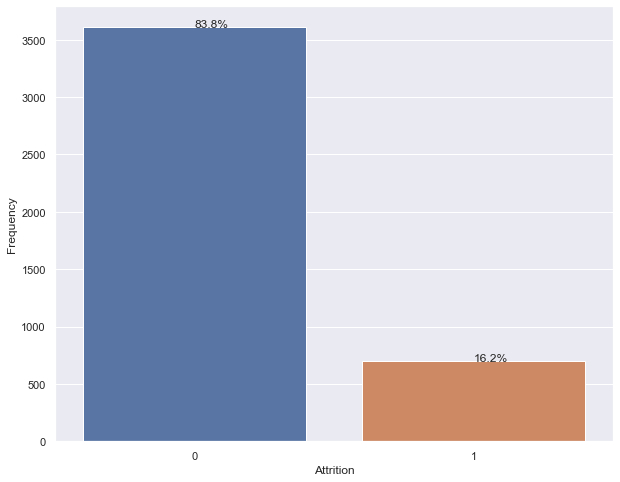

In [133]:
plt.figure(figsize=(10,8)) #perintah utk membuat object figure (gambar) dg size 25x18 inch
# plt.subplot(2,2,1) #membuat subplot 2x2 pada indeks pertama
ax = sns.countplot(x=df['Attrition']) #membuat plot jumlah dari kolom Gender 
plt.xlabel('Attrition')
plt.ylabel('Frequency')
#fungsi utk menampilkan angka presentase pada countplot
total = len(df['Attrition'])
for p in ax.patches:
  percentage = '{:.1f}%'.format(100*p.get_height()/total)
  x = p.get_x() + p.get_width()/2
  y = p.get_y() + p.get_height() + 0.02
  ax.annotate(percentage, (x,y))

plt.show()

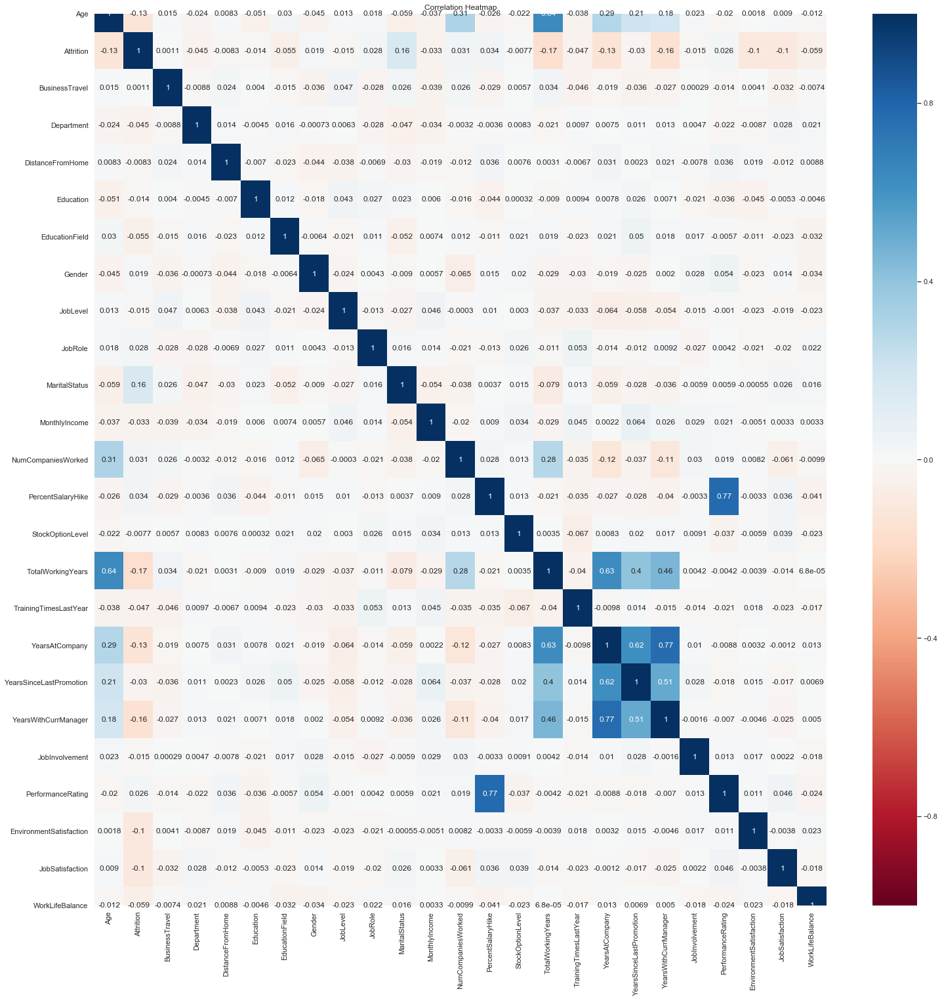

In [134]:
plt.figure(figsize= (25,25)) #membuat object figure (gambar) dg size 12x9 inch
s = sns.heatmap(df.corr(), #menghitung nilai korelasi antar feature
            annot = True, #menampilkan nilai korelasi pada heatmap
            cmap = 'RdBu', #mengeset colormaps (warna dari heatmap)
            vmin=-1, #mengeset nilai minimum dari koefisien korelasi
            vmax=1) #mengeset nilai max koefisien korelasi)
s.set_yticklabels(s.get_yticklabels(), rotation=0) #set label sumbu y
s.set_xticklabels(s.get_xticklabels()) #set label sumbu x
plt.title('Correlation Heatmap') #set judul heatmap
plt.show() #perintah utk menampilkan plot

In [135]:
df

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,JobInvolvement,PerformanceRating,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance
0,4,0,2,2,6,2,1,0,1,0,1,131160,0.0,11,0,1.0,6,1,0,0,3,3,3.0,4.0,2.0
1,2,1,1,1,10,1,1,0,1,6,2,41890,0.0,23,1,5.0,3,5,1,4,2,4,3.0,2.0,4.0
2,2,0,1,1,17,4,4,1,4,7,1,193280,0.0,15,3,5.0,2,5,0,3,3,3,2.0,2.0,1.0
3,2,0,0,1,2,5,1,1,3,1,1,83210,3.0,11,3,13.0,5,8,7,5,2,3,4.0,4.0,3.0
4,2,0,2,1,10,1,3,1,1,7,2,23420,4.0,12,2,9.0,2,6,0,4,3,3,4.0,1.0,3.0
5,3,0,2,1,8,3,1,0,4,5,1,40710,3.0,13,0,28.0,5,7,7,7,3,3,3.0,2.0,2.0
6,1,1,2,1,11,2,3,1,2,7,2,58130,2.0,20,1,5.0,2,0,0,0,3,4,1.0,3.0,1.0
7,1,0,2,1,18,3,1,1,2,7,1,31430,2.0,22,3,10.0,2,0,0,0,3,4,1.0,2.0,3.0
8,2,0,2,1,1,3,1,1,3,2,1,20440,0.0,21,0,9.0,2,9,7,8,3,4,2.0,4.0,3.0
9,1,0,0,1,7,4,3,0,4,2,0,134640,0.0,13,1,6.0,2,6,1,5,3,3,2.0,1.0,3.0


In [136]:
df.describe()

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,JobInvolvement,PerformanceRating,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance
count,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000,4306.000000
mean,2.149559,0.161635,1.607524,1.260799,9.189735,2.914073,2.246865,0.598235,2.065954,4.466094,1.100093,65028.880632,2.362517,15.210172,0.795170,11.143753,2.796563,7.022991,2.188110,4.131212,2.728751,3.153971,2.723641,2.724803,2.761496
std,0.921001,0.368158,0.665513,0.528430,8.094764,1.024690,1.328730,0.490312,1.106340,2.456192,0.729638,47025.219825,2.746135,3.662244,0.853134,7.831531,1.289985,6.145860,3.229425,3.565314,0.710496,0.360963,1.093655,1.101882,0.707691
min,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,10090.000000,0.000000,11.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000,1.000000,1.000000,1.000000
25%,1.000000,0.000000,1.000000,1.000000,2.000000,2.000000,1.000000,0.000000,1.000000,2.000000,1.000000,29147.500000,0.000000,12.000000,0.000000,6.000000,2.000000,3.000000,0.000000,2.000000,2.000000,3.000000,2.000000,2.000000,2.000000
50%,2.000000,0.000000,2.000000,1.000000,7.000000,3.000000,2.000000,1.000000,2.000000,5.000000,1.000000,49360.000000,2.000000,14.000000,1.000000,9.000000,3.000000,5.000000,1.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
75%,3.000000,0.000000,2.000000,2.000000,14.000000,4.000000,3.000000,1.000000,3.000000,7.000000,2.000000,83790.000000,4.000000,18.000000,1.000000,15.000000,3.000000,9.000000,3.000000,7.000000,3.000000,3.000000,4.000000,4.000000,3.000000
max,4.000000,1.000000,2.000000,2.000000,29.000000,5.000000,5.000000,1.000000,5.000000,8.000000,2.000000,199990.000000,9.000000,25.000000,3.000000,40.000000,6.000000,40.000000,15.000000,17.000000,4.000000,4.000000,4.000000,4.000000,4.000000


In [137]:
import numpy as np
#mensegmentasikan kelompok jarak rumah 
def DistanceFromHome(dataframe):
    dataframe.loc[dataframe['DistanceFromHome'] <= 5,'DistanceFromHome'] = 1
    dataframe.loc[(dataframe['DistanceFromHome'] > 5) & (dataframe['DistanceFromHome'] <= 10), 'DistanceFromHome'] = 2
    dataframe.loc[(dataframe['DistanceFromHome'] > 10) & (dataframe['DistanceFromHome'] <= 15), 'DistanceFromHome'] = 3
    dataframe.loc[(dataframe['DistanceFromHome'] > 15) & (dataframe['DistanceFromHome'] <= 20), 'DistanceFromHome'] = 4
    dataframe.loc[(dataframe['DistanceFromHome'] > 20) & (dataframe['DistanceFromHome'] <= 25), 'DistanceFromHome'] = 5
    dataframe.loc[(dataframe['DistanceFromHome'] > 25) & (dataframe['DistanceFromHome'] <= 30), 'DistanceFromHome'] = 6
    return dataframe

DistanceFromHome(df); 

In [138]:
# mensegmentasikan monthly salary (10.000-200.000$)
def MonthlyIncome(dataframe):
    dataframe.loc[dataframe['MonthlyIncome'] <= 50000,'MonthlyIncome'] = 1
    dataframe.loc[(dataframe['MonthlyIncome'] > 50000) & (dataframe['MonthlyIncome'] <= 100000), 'MonthlyIncome'] = 2
    dataframe.loc[(dataframe['MonthlyIncome'] > 100000) & (dataframe['MonthlyIncome'] <= 150000), 'MonthlyIncome'] = 3
    dataframe.loc[dataframe['MonthlyIncome'] > 150000, 'MonthlyIncome'] = 4
    return dataframe

MonthlyIncome(df); 

In [139]:
# mensegmentasikan total working years (1-40 tahun)
def TotalWorkingYears(dataframe):
    dataframe.loc[dataframe['TotalWorkingYears'] <= 10,'TotalWorkingYears'] = 1
    dataframe.loc[(dataframe['TotalWorkingYears'] > 10) & (dataframe['TotalWorkingYears'] <= 20), 'TotalWorkingYears'] = 2
    dataframe.loc[(dataframe['TotalWorkingYears'] > 20) & (dataframe['TotalWorkingYears'] <= 30), 'TotalWorkingYears'] = 3
    dataframe.loc[dataframe['TotalWorkingYears'] > 30, 'TotalWorkingYears'] = 4
    return dataframe

TotalWorkingYears(df); 

In [140]:
# mensegmentasikan Years at Company (1-40 tahun)
def YearsAtCompany(dataframe):
    dataframe.loc[dataframe['YearsAtCompany'] <= 10,'YearsAtCompany'] = 1
    dataframe.loc[(dataframe['YearsAtCompany'] > 10) & (dataframe['YearsAtCompany'] <= 20), 'YearsAtCompany'] = 2
    dataframe.loc[(dataframe['YearsAtCompany'] > 20) & (dataframe['YearsAtCompany'] <= 30), 'YearsAtCompany'] = 3
    dataframe.loc[dataframe['YearsAtCompany'] > 30, 'YearsAtCompany'] = 4
    return dataframe

YearsAtCompany(df); 

In [141]:
# mensegmentasikan Years with Current Manager (1-17 tahun)
def YearsWithCurrManager(dataframe):
    dataframe.loc[dataframe['YearsWithCurrManager'] <= 5,'YearsWithCurrManager'] = 1
    dataframe.loc[(dataframe['YearsWithCurrManager'] > 5) & (dataframe['YearsWithCurrManager'] <= 10), 'YearsWithCurrManager'] = 2
    dataframe.loc[(dataframe['YearsWithCurrManager'] > 10) & (dataframe['YearsWithCurrManager'] <= 15), 'YearsWithCurrManager'] = 3
    dataframe.loc[dataframe['YearsWithCurrManager'] > 15, 'YearsWithCurrManager'] = 4
    return dataframe

YearsWithCurrManager(df); 

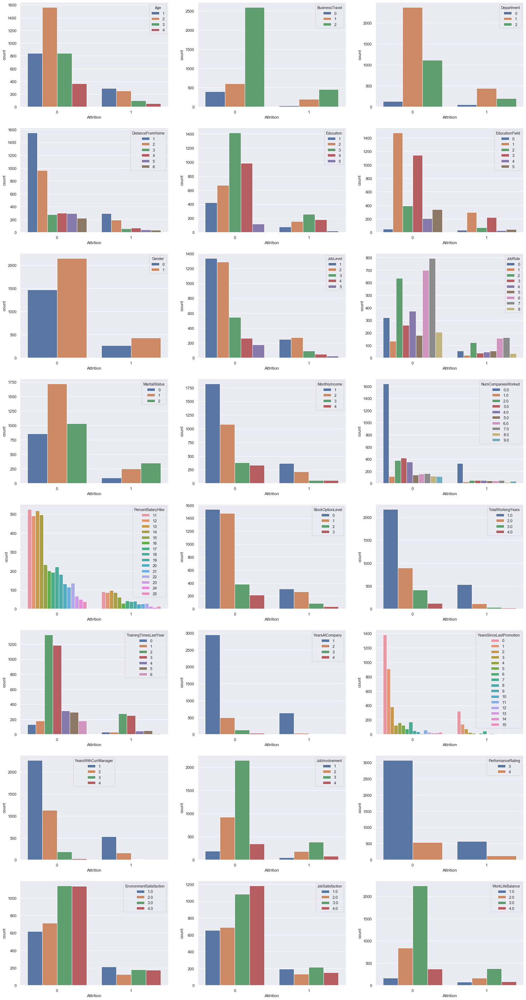

In [142]:
plt.figure(figsize = (25,50))
y = (["","Age", "BusinessTravel", "Department", "DistanceFromHome", 
      "Education", "EducationField", "Gender", "JobLevel", "JobRole", "MaritalStatus", "MonthlyIncome",
      "NumCompaniesWorked", "PercentSalaryHike", "StockOptionLevel", "TotalWorkingYears", "TrainingTimesLastYear",
      "YearsAtCompany", "YearsSinceLastPromotion", "YearsWithCurrManager", "JobInvolvement", "PerformanceRating", 
      "EnvironmentSatisfaction", "JobSatisfaction", "WorkLifeBalance"])
for i in range(1,25):
    plt.subplot(8,3,i)
    sns.countplot(x = "Attrition",data=df,hue=y[i]) #hue : names of variables in data or vector data

plt.show()

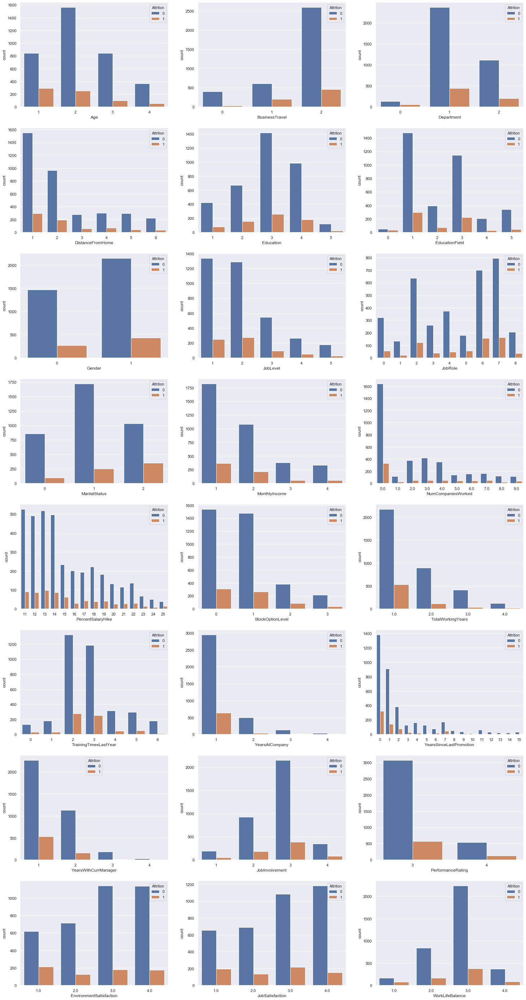

In [143]:
plt.figure(figsize = (25,50))
x = (["","Age", "BusinessTravel", "Department", "DistanceFromHome", 
      "Education", "EducationField", "Gender", "JobLevel", "JobRole", "MaritalStatus", "MonthlyIncome",
      "NumCompaniesWorked", "PercentSalaryHike", "StockOptionLevel", "TotalWorkingYears", "TrainingTimesLastYear",
      "YearsAtCompany", "YearsSinceLastPromotion", "YearsWithCurrManager", "JobInvolvement", "PerformanceRating", 
      "EnvironmentSatisfaction", "JobSatisfaction", "WorkLifeBalance"])
for i in range(1,25):
    plt.subplot(8,3,i)
    sns.countplot(x = x[i], data=df, hue="Attrition") #hue : names of variables in data or vector data

plt.show()

In [144]:
df.corr().sort_values(by="Attrition")

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,JobInvolvement,PerformanceRating,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance
Age,1.000000,-0.127486,0.015445,-0.024320,0.011943,-0.051359,0.029994,-0.044888,0.013342,0.017850,-0.058577,-0.041963,0.307631,-0.026125,-0.021607,0.582457,-0.037536,0.261945,0.206559,0.165449,0.022607,-0.020373,0.001839,0.008979,-0.011548
TotalWorkingYears,0.582457,-0.115325,0.021790,-0.011925,0.002825,-0.028709,0.002725,-0.006079,-0.056442,0.001192,-0.082478,-0.026018,0.220843,-0.008558,0.010169,1.000000,-0.028744,0.616338,0.388670,0.376635,0.014256,0.003958,0.015567,-0.007562,-0.006500
YearsWithCurrManager,0.165449,-0.109878,-0.024805,0.022396,0.016195,0.005857,0.012209,0.009628,-0.068243,0.008745,-0.029189,0.024029,-0.108019,-0.046809,0.026586,0.376635,-0.008446,0.566893,0.498717,1.000000,-0.006215,-0.004161,0.002267,-0.024945,0.019587
EnvironmentSatisfaction,0.001839,-0.103645,0.004134,-0.008702,0.018007,-0.044617,-0.011386,-0.022569,-0.022944,-0.021303,-0.000550,-0.003952,0.008152,-0.003300,-0.005912,0.015567,0.018097,-0.000948,0.015314,0.002267,0.016505,0.010724,1.000000,-0.003756,0.023164
JobSatisfaction,0.008979,-0.102189,-0.032020,0.028343,-0.002385,-0.005313,-0.023396,0.013719,-0.019216,-0.020142,0.025602,-0.003453,-0.061445,0.035980,0.038863,-0.007562,-0.022564,-0.010833,-0.017435,-0.024945,0.002246,0.046404,-0.003756,1.000000,-0.018358
YearsAtCompany,0.261945,-0.068521,-0.019487,0.005169,0.045707,0.010251,0.000639,-0.005184,-0.069332,0.001159,-0.039393,-0.022508,-0.058025,-0.021127,0.023609,0.616338,0.007092,1.000000,0.545968,0.566893,0.009143,-0.009298,-0.000948,-0.010833,0.014074
WorkLifeBalance,-0.011548,-0.058844,-0.007434,0.021020,0.013705,-0.004564,-0.031983,-0.033882,-0.022627,0.022408,0.015653,0.004887,-0.009884,-0.041063,-0.022838,-0.006500,-0.016521,0.014074,0.006931,0.019587,-0.017820,-0.024435,0.023164,-0.018358,1.000000
EducationField,0.029994,-0.054996,-0.015445,0.016135,-0.022425,0.012001,1.000000,-0.006391,-0.020559,0.010857,-0.051849,0.007467,0.012327,-0.011190,0.020642,0.002725,-0.022733,0.000639,0.049697,0.012209,0.016569,-0.005653,-0.011386,-0.023396,-0.031983
TrainingTimesLastYear,-0.037536,-0.046665,-0.046216,0.009698,-0.012786,0.009442,-0.022733,-0.030095,-0.032752,0.052587,0.013248,0.049353,-0.034782,-0.034856,-0.067211,-0.028744,1.000000,0.007092,0.013760,-0.008446,-0.013842,-0.021013,0.018097,-0.022564,-0.016521
Department,-0.024320,-0.044794,-0.008752,1.000000,0.003908,-0.004506,0.016135,-0.000733,0.006331,-0.027995,-0.047236,-0.032762,-0.003219,-0.003604,0.008257,-0.011925,0.009698,0.005169,0.011400,0.022396,0.004710,-0.021810,-0.008702,0.028343,0.021020


-------------------------------------------------------------------------------------------------------------------------------

# Build the Model

## Import Clean Data

In [145]:
## Membaca data csv ke Dataframe Pandas
data = pd.read_csv('Data_Obj_HR_Clean.csv')

In [146]:
data.isna().sum()

Age                        0 
Attrition                  0 
BusinessTravel             0 
Department                 0 
DistanceFromHome           0 
Education                  0 
EducationField             0 
EmployeeID                 0 
Gender                     0 
JobLevel                   0 
JobRole                    0 
MaritalStatus              0 
MonthlyIncome              0 
NumCompaniesWorked         0 
PercentSalaryHike          0 
StockOptionLevel           0 
TotalWorkingYears          0 
TrainingTimesLastYear      0 
YearsAtCompany             0 
YearsSinceLastPromotion    0 
YearsWithCurrManager       0 
JobInvolvement             0 
PerformanceRating          0 
EnvironmentSatisfaction    25
JobSatisfaction            20
WorkLifeBalance            38
dtype: int64

In [147]:
#drop useless kolom 
data.drop(['EnvironmentSatisfaction','JobSatisfaction','WorkLifeBalance', 'JobInvolvement', 'PerformanceRating'],axis=1, inplace = True)

In [148]:
# data_only = data.drop('EmployeeID', axis=1)

## Split Data 

In [149]:
y = data['Attrition'] #dependent variabel
x = data.drop('Attrition', axis = 1) #independent variabel

In [150]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state=42)

In [151]:
x

,Age,BusinessTravel,Department,DistanceFromHome,Education,EducationField,EmployeeID,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager
0,4,2,2,6,2,1,1,0,1,0,1,131160,0.0,11,0,1.0,6,1,0,0
1,2,1,1,10,1,1,2,0,1,6,2,41890,0.0,23,1,5.0,3,5,1,4
2,2,1,1,17,4,4,3,1,4,7,1,193280,0.0,15,3,5.0,2,5,0,3
3,2,0,1,2,5,1,4,1,3,1,1,83210,3.0,11,3,13.0,5,8,7,5
4,2,2,1,10,1,3,5,1,1,7,2,23420,4.0,12,2,9.0,2,6,0,4
5,3,2,1,8,3,1,6,0,4,5,1,40710,3.0,13,0,28.0,5,7,7,7
6,1,2,1,11,2,3,7,1,2,7,2,58130,2.0,20,1,5.0,2,0,0,0
7,1,2,1,18,3,1,8,1,2,7,1,31430,2.0,22,3,10.0,2,0,0,0
8,2,2,1,1,3,1,9,1,3,2,1,20440,0.0,21,0,9.0,2,9,7,8
9,1,0,1,7,4,3,10,0,4,2,0,134640,0.0,13,1,6.0,2,6,1,5


In [152]:
#mengedrop sementara data Employee ID setelah data displit menjadi data training dan data testing
X_train = X_train.drop('EmployeeID', axis =1 )
X_test_ID = X_test.drop('EmployeeID', axis =1 )

## Standardize Data

In [153]:
Scaler = StandardScaler()
X_train = Scaler.fit_transform(X_train)
X_test_ID = Scaler.transform(X_test_ID)

In [154]:
lr = LogisticRegression()
lr.fit(X_train,y_train)
y_pred = lr.predict(X_test_ID)

print(accuracy_score(y_test,y_pred))
print(confusion_matrix(y_test,y_pred))

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


0.8587699316628702
[[749   4]
 [120   5]]


In [155]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test_ID)

print(accuracy_score(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


0.989749430523918
[[753   0]
 [  9 116]]


# Print Attrition Probability each Employee on Data Testing

In [156]:
prob=rfc.predict_proba(X_test_ID)
X_test['At Rate'] = prob[:,1]

C:\Users\AGHA\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [157]:
import numpy as np
np.mean(X_test_ID),np.std(X_test_ID)

(0.015849102384203066, 1.0043384907466906)

In [158]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)
X_test

,Age,BusinessTravel,Department,DistanceFromHome,Education,EducationField,EmployeeID,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,At Rate
4239,1,2,1,26,3,5,4261,1,1,2,1,88530,0.0,22,1,2.0,3,2,2,1,0.0
3024,2,0,0,28,3,0,3041,1,2,2,2,24320,4.0,22,0,7.0,4,1,0,0,0.2
2607,2,2,1,8,1,3,2623,0,5,6,1,35440,3.0,18,3,15.0,3,11,5,10,0.0
912,1,2,1,18,4,3,921,0,2,7,2,37430,0.0,13,1,2.0,2,2,2,2,0.2
877,3,0,2,2,4,1,886,1,2,4,1,58550,0.0,14,1,10.0,3,10,4,5,0.0
151,4,2,1,10,3,1,154,0,1,4,1,22690,5.0,18,1,33.0,4,29,11,10,0.0
3209,3,1,1,27,3,1,3227,1,1,6,0,54410,9.0,22,1,28.0,6,22,11,13,0.0
4296,3,2,1,4,3,1,4318,0,2,4,2,43740,3.0,15,1,21.0,5,5,4,4,0.0
3525,3,2,1,2,3,1,3544,1,2,6,1,165550,8.0,14,2,28.0,4,26,15,9,0.0
3655,2,2,1,1,4,3,3674,1,5,5,1,191890,0.0,12,1,3.0,3,3,1,2,0.0


# Make a Template for Manager 

Dengan asumsi data keseluruhan karyawan di bulan/tahun selanjutnya memiliki format yang sama dengan file general_data.csv, maka akan dibuat template file notebook untuk pengecekan attrition rate tiap karyawan.

Notebook tidak dipisah dengan notebook sebelumnya, supaya apabila data yang digunakan untuk data training suatu saat diupdate, manager hanya perlu mengerun 1 notebook saja, mengingat jumlah data tidak terlalu banyak.

## Import Data  

In [159]:
df_input = pd.read_csv('example2.csv') #nama file csv data yang akan dianalisis
input_test = df_input.drop('EmployeeID', axis =1)

In [160]:
input_test

,Age,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager
0,52,Travel_Rarely,Sales,21,5,Technical Degree,Male,3,Manager,Married,28890,1,11,1,34,2,34,1,16
1,33,Travel_Rarely,Research & Development,1,2,Medical,Male,3,Laboratory Technician,Single,28710,1,17,3,10,2,10,7,8
2,25,Travel_Rarely,Research & Development,8,3,Life Sciences,Male,2,Research Scientist,Single,74840,1,15,0,6,3,6,1,4
3,45,Travel_Rarely,Sales,2,3,Life Sciences,Male,3,Healthcare Representative,Single,60740,0,14,0,9,2,8,3,1
4,23,Travel_Rarely,Research & Development,23,1,Life Sciences,Female,2,Research Scientist,Single,173280,1,17,1,2,2,2,0,2
5,47,Travel_Frequently,Research & Development,4,3,Life Sciences,Male,1,Research Director,Single,27740,4,13,1,8,2,5,1,3
6,34,Travel_Rarely,Research & Development,12,3,Technical Degree,Male,1,Research Scientist,Single,45050,1,12,0,6,3,6,1,4
7,55,Travel_Rarely,Human Resources,7,3,Human Resources,Male,4,Laboratory Technician,Married,74280,5,12,0,24,2,5,1,4
8,36,Non-Travel,Research & Development,7,2,Life Sciences,Male,5,Sales Executive,Single,116310,1,18,1,10,2,10,0,9
9,52,Non-Travel,Research & Development,1,4,Life Sciences,Male,5,Sales Executive,Married,97380,0,18,2,5,2,4,1,2


In [161]:
#mensegmentasikan employee berdasar usia, diket rentang usia: 18-60 th, shg pengelompokkan dilakukan dg rentang usia dlm 1 kelompok ~ 10 th 
def Age(dataframe):
    dataframe.loc[dataframe['Age'] <= 30,'Age'] = 1
    dataframe.loc[(dataframe['Age'] > 30) & (dataframe['Age'] <= 40), 'Age'] = 2
    dataframe.loc[(dataframe['Age'] > 40) & (dataframe['Age'] <= 50), 'Age'] = 3
    dataframe.loc[(dataframe['Age'] > 50) & (dataframe['Age'] <= 60), 'Age'] = 4
    return dataframe

Age(input_test); 

## Preprocesing Data

In [162]:
from sklearn.preprocessing import LabelEncoder #untuk menconvert label datanya(?)
# labelEncoder_X = LabelEncoder()
input_test['BusinessTravel'] = LabelEncoder().fit_transform(input_test['BusinessTravel'])
input_test['Department'] = LabelEncoder().fit_transform(input_test['Department'])
input_test['EducationField'] = LabelEncoder().fit_transform(input_test['EducationField'])
input_test['Gender'] = LabelEncoder().fit_transform(input_test['Gender'])
input_test['JobRole'] = LabelEncoder().fit_transform(input_test['JobRole'])
input_test['MaritalStatus'] = LabelEncoder().fit_transform(input_test['MaritalStatus'])
#df['Over18'] = LabelEncoder().fit_transform(df['Over18'])

In [163]:
input_test.to_numpy()

array([[     4,      2,      2,     21,      5,      4,      1,      3,
             3,      1,  28890,      1,     11,      1,     34,      2,
            34,      1,     16],
       [     2,      2,      1,      1,      2,      3,      1,      3,
             2,      2,  28710,      1,     17,      3,     10,      2,
            10,      7,      8],
       [     1,      2,      1,      8,      3,      1,      1,      2,
             6,      2,  74840,      1,     15,      0,      6,      3,
             6,      1,      4],
       [     3,      2,      2,      2,      3,      1,      1,      3,
             0,      2,  60740,      0,     14,      0,      9,      2,
             8,      3,      1],
       [     1,      2,      1,     23,      1,      1,      0,      2,
             6,      2, 173280,      1,     17,      1,      2,      2,
             2,      0,      2],
       [     3,      1,      1,      4,      3,      1,      1,      1,
             5,      2,  27740,      4,    

In [164]:
input_test = Scaler.fit_transform(input_test)
np.mean(input_test),np.std(input_test)
#check whether the normalized data has a mean of zero and a standard deviation of one

(-9.047657925637949e-18, 1.0)

In [165]:
prob=rfc.predict_proba(input_test)
df_input['At Rate'] = prob[:,1]
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)

df_input.sort_values(by='At Rate', ascending = False)

,EmployeeID,Age,BusinessTravel,Department,DistanceFromHome,Education,EducationField,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,At Rate
7,3251,55,Travel_Rarely,Human Resources,7,3,Human Resources,Male,4,Laboratory Technician,Married,74280,5,12,0,24,2,5,1,4,0.9
30,3274,33,Travel_Rarely,Research & Development,23,5,Life Sciences,Male,1,Human Resources,Single,86390,5,16,2,6,3,3,0,2,0.7
1,3245,33,Travel_Rarely,Research & Development,1,2,Medical,Male,3,Laboratory Technician,Single,28710,1,17,3,10,2,10,7,8,0.7
10,3254,26,Travel_Frequently,Research & Development,2,2,Life Sciences,Male,1,Manufacturing Director,Divorced,28350,3,11,1,5,2,2,2,0,0.6
12,3256,26,Travel_Rarely,Research & Development,15,2,Life Sciences,Male,2,Laboratory Technician,Single,26130,6,19,1,6,2,4,1,2,0.6
24,3268,23,Travel_Rarely,Sales,2,3,Medical,Female,4,Manufacturing Director,Married,45590,1,18,1,1,2,0,0,0,0.5
28,3272,29,Travel_Rarely,Sales,2,4,Marketing,Female,4,Research Scientist,Married,106500,1,13,2,1,2,1,0,0,0.4
17,3261,38,Travel_Frequently,Sales,2,4,Life Sciences,Female,2,Research Scientist,Single,23680,6,11,1,17,3,15,4,12,0.4
4,3248,23,Travel_Rarely,Research & Development,23,1,Life Sciences,Female,2,Research Scientist,Single,173280,1,17,1,2,2,2,0,2,0.3
5,3249,47,Travel_Frequently,Research & Development,4,3,Life Sciences,Male,1,Research Director,Single,27740,4,13,1,8,2,5,1,3,0.3


In [166]:
df_input.to_csv("Hasil_Prediksi.csv", index=False) #save data hasil dlm format csv